Object Detection

Библиотека ImageAI предоставляет очень удобные и мощные методы для обнаружения объектов на изображениях. Чтобы приступить к обнаружению объектов, необходимо загрузить уже обученные модели обнаружения объектов. Воспользуемся моделью YOLO. 

Установим библиотеки конкретных версий, чтобы все заработало :)

In [1]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
!pip install -q tensorflow==2.8.0
!pip install -q tensorflow-gpu==2.8.0
!git clone https://github.com/dvolchek/YOLOv3-TensorFlow-2.x.git
%cd YOLOv3-TensorFlow-2.x
!wget -P model_data https://pjreddie.com/media/files/yolov3.weights

fatal: destination path 'YOLOv3-TensorFlow-2.x' already exists and is not an empty directory.
/content/YOLOv3-TensorFlow-2.x
--2023-06-11 10:39:30--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘model_data/yolov3.weights.1’

yolov3.weights.1    100%[===================>] 236.52M  39.7MB/s    in 6.4s    

2023-06-11 10:39:37 (37.1 MB/s) - ‘model_data/yolov3.weights.1’ saved [248007048/248007048]



Не забудьте подгрузить файл изображения в сессионное хранилище. Теперь можно выполнять распознование. Выполняем распознавание объектов для изображения с именем 42.jpg. Изображение с распознанными объектами будет сохранено в файле detected.jpg

**NB: Для детектирования людей на последующих изображениях достаточно изменять имена файлов в следующем блоке и запускать его. Весь код сначала выполнять не нужно**



In [5]:
from imutils import paths
import detection_demo

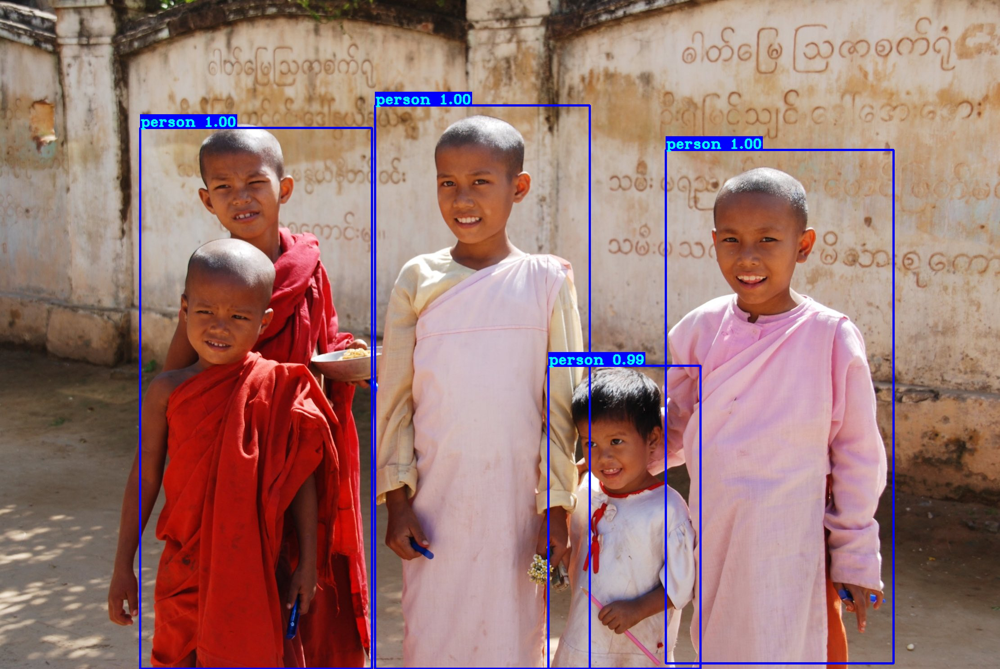

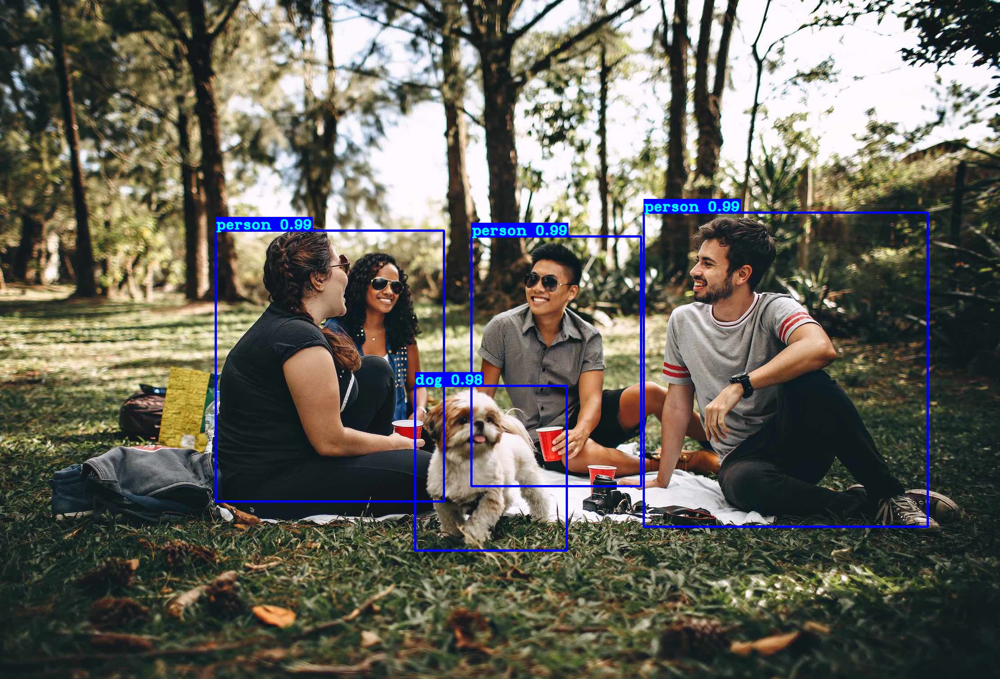

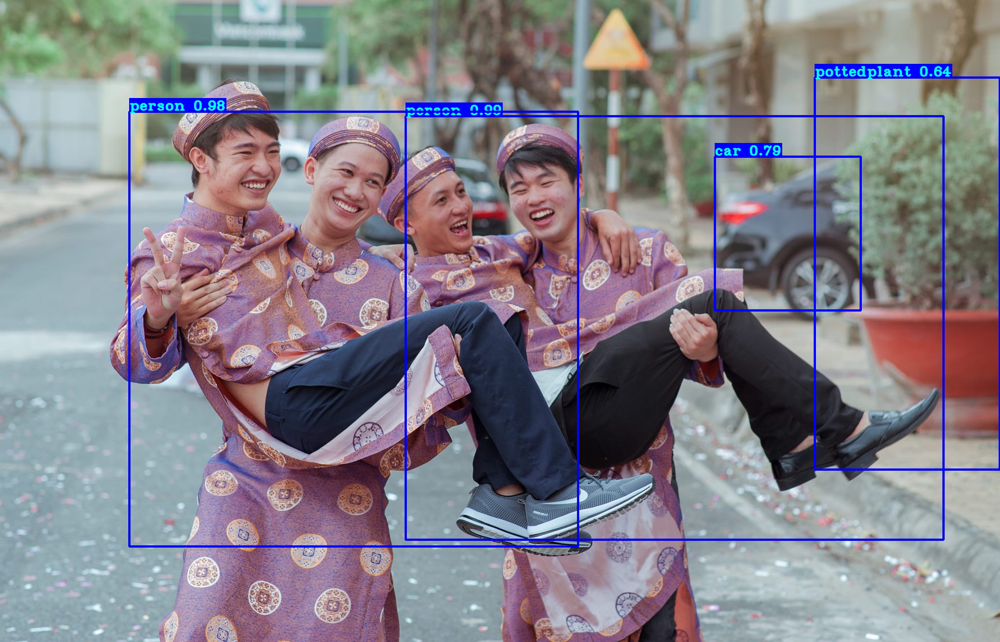

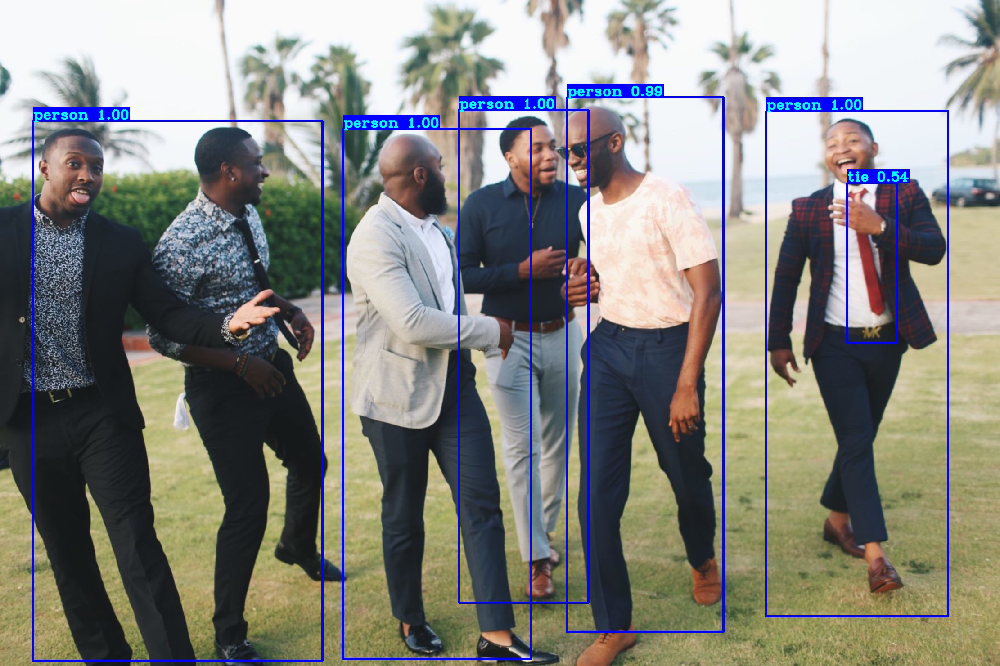

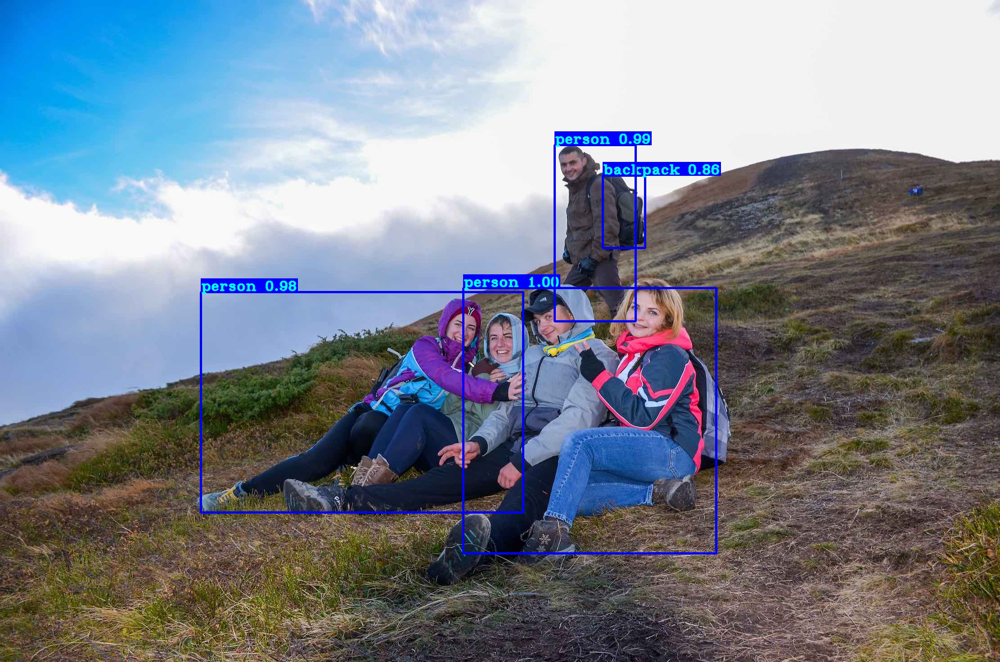

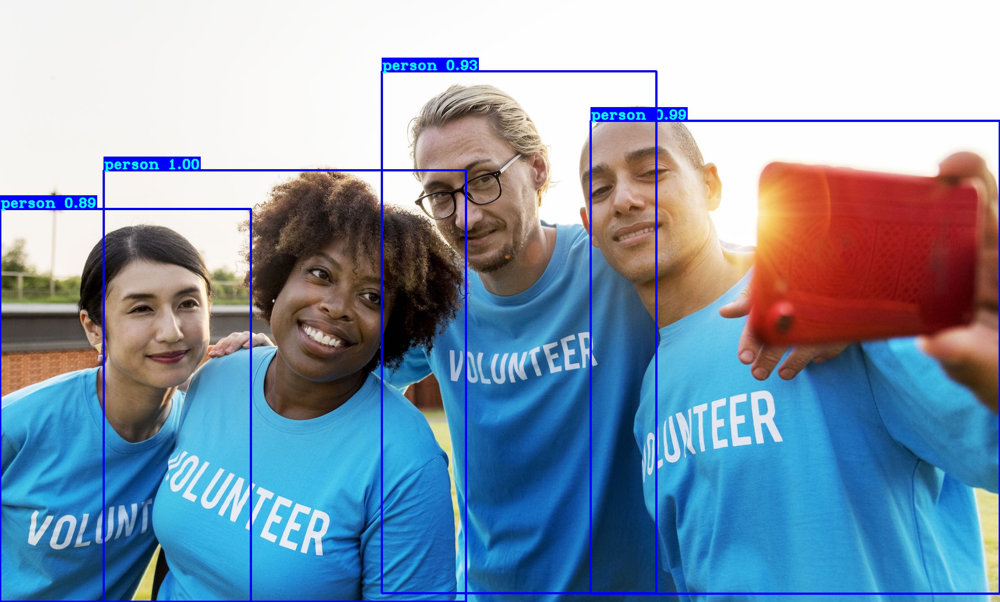

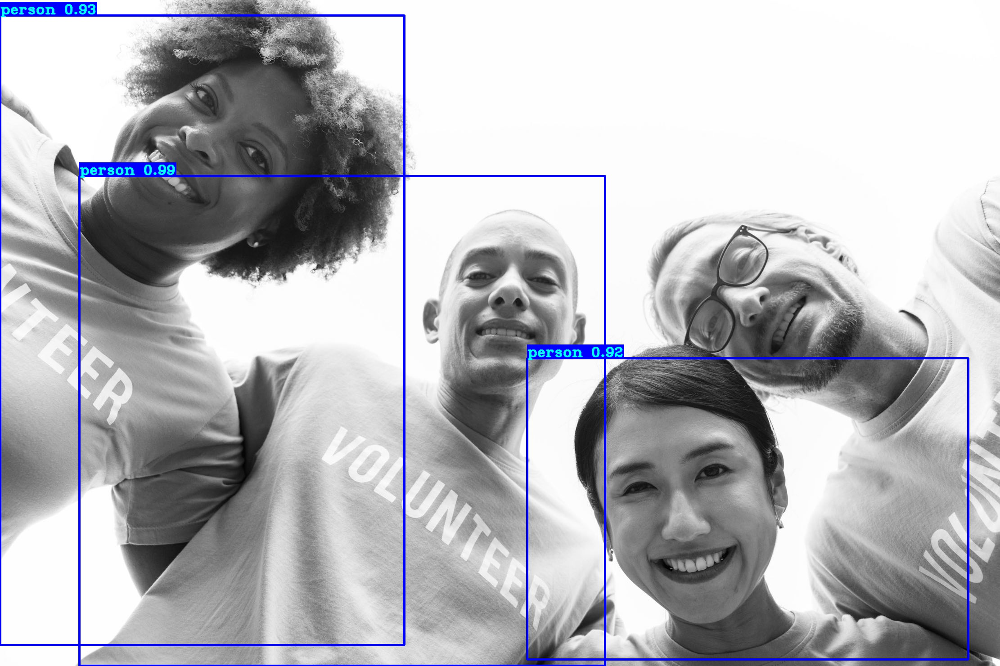

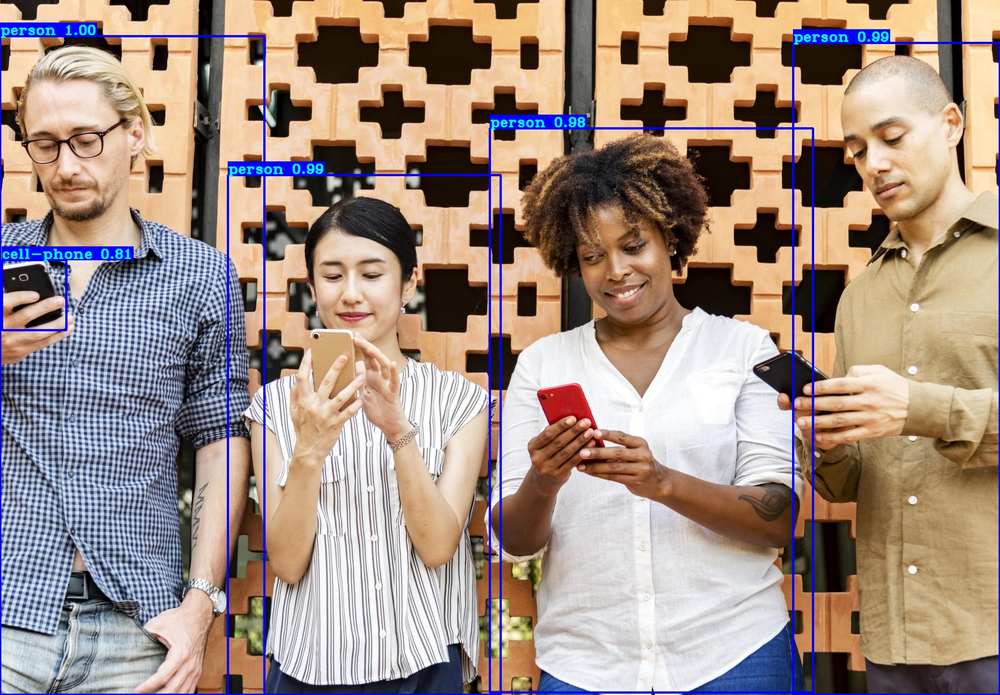

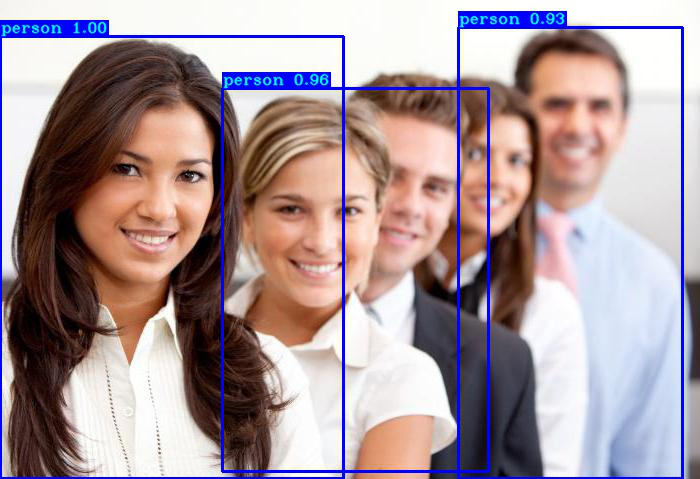

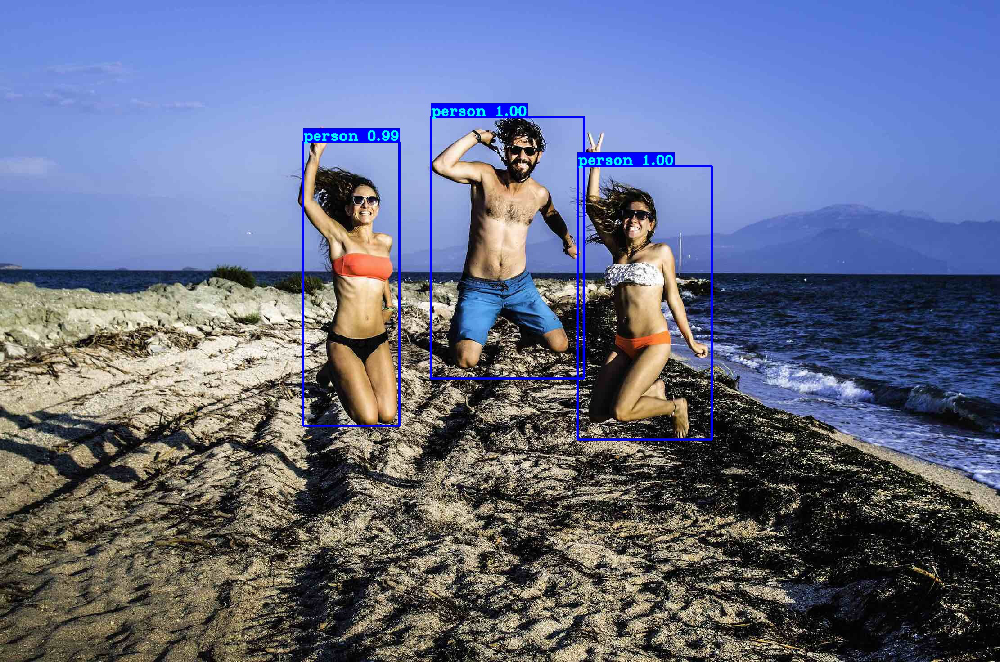

In [8]:
image_paths = sorted(list(paths.list_images('/content/imgs')))

for i in image_paths:
  detection_demo.detect(i)
  from PIL import Image
  image = Image.open('/content/detected.jpg')
  image.show()

- 12.jpg: TP = 4, TN = 0, FP = 0, FN = 1.
- 20.jpg: TP = 3, TN = 0, FP = 0, FN = 1.
- 22.jpg: TP = 2, TN = 0, FP = 0, FN = 2.
- 26.jpg: TP = 5, TN = 0, FP = 0, FN = 1.
- 28.jpg: TP = 3, TN = 0, FP = 0, FN = 2.
- 33.jpg: TP = 4, TN = 0, FP = 0, FN = 0.
- 34.jpg: TP = 3, TN = 0, FP = 0, FN = 1.
- 35.jpg: TP = 4, TN = 0, FP = 0, FN = 0.
- 42.jpg: TP = 3, TN = 0, FP = 0, FN = 2.
- 8.jpg: TP = 3, TN = 0, FP = 0, FN = 0.


---

- TP = 34
- TN = 0
- FP = 0
- FN = 10

---

|   | T  | F  |
|---|----|----|
| T | TP | FP  |
| F | FN | TN |

|               |   | Действительный | класс |
|---------------|---|----------------|-------|
|               |   | T              | F     |
| Предсказанный | T | 34             | 0     |
| класс         | F | 10             | 0     |

In [12]:
tp = 34
tn = 0
fp = 0
fn = 10
print('F1 =', round(2*tp/(2*tp+fp+fn), 3))

F1 = 0.872
